In [1]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.utils.data as Data

import torchvision
from torchvision import transforms, utils
from torchvision.models import vgg16

import numpy as np
from collections import namedtuple
from tqdm import tqdm

import matplotlib as cm
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

from PIL import Image
from collections import namedtuple
import torchvision.utils as vutils

import os
import warnings
warnings.filterwarnings("ignore")
%matplotlib inline

In [3]:
# Dataset

from sklearn.model_selection import train_test_split
from torch.utils.data import Dataset, DataLoader
from glob import glob



paths = glob(args.dataset_path)
transform = transforms.Compose([
            transforms.Resize(args.image_size),
            transforms.CenterCrop(args.image_size),
            transforms.ToTensor(),
            transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
        ])

class CustomeDataset(Dataset):
    def __init__(self, paths: list, transforms: transforms.Compose):        
        self.paths = paths
        self.transforms = transforms
    
    def __len__(self):        
        return len(self.paths)

    def __getitem__(self, i):
        img = Image.open(self.paths[i]).convert('RGB')
        tensor = self.transforms(img)
        return tensor

train, test = train_test_split(paths, test_size=0.1, random_state=22)

train_dataset = CustomeDataset(paths=train, transforms=transform)
test_dataset = CustomeDataset(paths=test, transforms=transform)

train_dataloader = DataLoader(train_dataset, batch_size=args.batch_size, num_workers=2, shuffle=True)
test_dataloader = DataLoader(test_dataset, batch_size=args.batch_size, num_workers=2, shuffle=False )

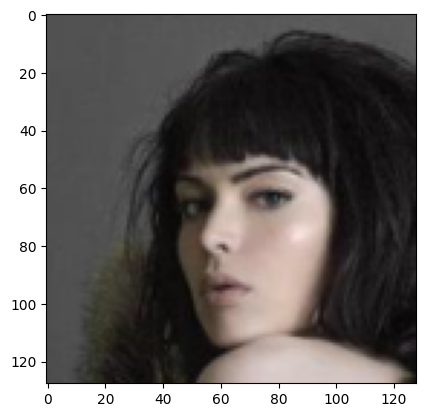

In [4]:
def visual(img):
    img = img * 0.5 + 0.5
    plt.imshow(img.permute(1,2,0).numpy())
    plt.show()
visual(next(iter(train_dataloader))[0])

# Utils

In [5]:
class GroupNorm(nn.Module):
    def __init__(self, in_channels):
        super(GroupNorm, self).__init__()
        self.gn = nn.GroupNorm(num_groups=32, num_channels=in_channels, eps=1e-6, affine=True)

    def forward(self, x):
        return self.gn(x)


class Swish(nn.Module):
    def forward(self, x):
        return x * torch.sigmoid(x)
        
class ResidualBlock(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(ResidualBlock, self).__init__()

        self.in_channels = in_channels
        self.out_channels = out_channels
        self.block = nn.Sequential(
            GroupNorm(in_channels),
            Swish(),
            nn.Conv2d(in_channels, out_channels, 3, 1, 1),
            GroupNorm(out_channels),
            Swish(),
            nn.Conv2d(out_channels, out_channels, 3, 1, 1)
        )

        if in_channels != out_channels:
            self.channel_up = nn.Conv2d(in_channels, out_channels, 1, 1, 0)

    def forward(self, x):
        if self.in_channels != self.out_channels:
            return self.channel_up(x) + self.block(x)
        else:
            return x + self.block(x)



class NonLocalBlock(nn.Module):
    def __init__(self, in_channels):
        super(NonLocalBlock, self).__init__()
        
        self.in_channels = in_channels
        self.gn = GroupNorm(in_channels=in_channels)
        self.q = nn.Conv2d(in_channels, in_channels, 1, 1, 0)
        self.k = nn.Conv2d(in_channels, in_channels, 1, 1, 0)
        self.v = nn.Conv2d(in_channels, in_channels, 1, 1, 0)

        self.proj_out = nn.Conv2d(in_channels, in_channels, 1, 1, 0)
    
    def forward(self, x):
        hidden_state = self.gn(x)
        q = self.q(hidden_state)
        k = self.k(hidden_state)
        v = self.v(hidden_state)

        b, c, h, w = q.shape

        q = q.reshape(b, c, h * w)
        q = q.permute(0, 2, 1)
        k = k.reshape(b, c, h * w)
        v = v.reshape(b, c, h * w)

        attention = torch.bmm(q, k)
        attention = attention * (int(c)**(-0.5))
        attention = F.softmax(attention, dim=2)
        attention = attention.permute(0, 2, 1)

        A = torch.bmm(v, attention)
        A = A.reshape(b, c, h, w)
        A = x + A
        
        return A


class UpSampleBlock(nn.Module):
    def __init__(self, channels):
        super(UpSampleBlock, self).__init__()
        self.conv = nn.Conv2d(channels, channels, 3, 1, 1)

    def forward(self, x):
        x = F.interpolate(x, scale_factor=2.0)
        return self.conv(x)

class DownSampleBlock(nn.Module):
    def __init__(self, channels):
        super(DownSampleBlock, self).__init__()
        self.conv = nn.Conv2d(channels, channels, 3, 2, 0)

    def forward(self, x):
        pad = (0, 1, 0, 1)
        x = F.pad(x, pad, mode="constant", value=0)
        return self.conv(x)

class ScalingLayer(nn.Module):
    def __init__(self):
        super(ScalingLayer, self).__init__()
        self.register_buffer("shift", torch.Tensor([-.030, -.088, -.188])[None, :, None, None])
        self.register_buffer("scale", torch.Tensor([.458, .448, .450])[None, :, None, None])

    def forward(self, x):
        return (x - self.shift) / self.scale

class NetLinLayer(nn.Module):
    def __init__(self, in_channels, out_channels=1):
        super(NetLinLayer, self).__init__()
        self.model = nn.Sequential(
            nn.Dropout(),
            nn.Conv2d(in_channels, out_channels, 1, 1, 0, bias=False)
        )


URL_MAP = {
    "vgg_lpips": "https://heibox.uni-heidelberg.de/f/607503859c864bc1b30b/?dl=1"
}
CKPT_MAP = {
    "vgg_lpips": "vgg.pth"
}

def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

def download(url, local_path, chunk_size=1024):
    os.makedirs(os.path.split(local_path)[0], exist_ok=True)
    with requests.get(url, stream=True) as r:
        total_size = int(r.headers.get("content-length", 0))
        with tqdm(total=total_size, unit="B", unit_scale=True) as pbar:
            with open(local_path, "wb") as f:
                for data in r.iter_content(chunk_size=chunk_size):
                    if data:
                        f.write(data)
                        pbar.update(chunk_size)

def get_ckpt_path(name, root):
    assert name in URL_MAP
    path = os.path.join(root, CKPT_MAP[name])
    if not os.path.exists(path):
        print(f"Downloading {name} model from {URL_MAP[name]} to {path}")
        download(URL_MAP[name], path)
    return path

def spatial_average(x):
    return x.mean([2, 3], keepdim=True)

# Arch.

In [6]:
class CodeBook(nn.Module):
    def __init__(self, latent_dim, num_vectors, beta):
        super(CodeBook, self).__init__()
        
        self.latent_dim = latent_dim 
        self.num_vectors = num_vectors
        self.beta = beta

        self.embedding = nn.Embedding(self.num_vectors, self.latent_dim)
        self.embedding.weight.data.uniform_(-1.0 / self.num_vectors, 1.0 / self.num_vectors)

    def forward(self, z):
        z = z.permute(0, 2, 3, 1).contiguous()
        z_flatten = z.view(-1, self.latent_dim)

        distance = torch.sum(z_flatten**2, dim=1, keepdim=True) + torch.sum(self.embedding.weight**2, dim=1) - 2 * (torch.matmul(z_flatten, self.embedding.weight.t()))
        min_encoding_index = torch.argmin(distance, dim=1)

        z_q = self.embedding(min_encoding_index).view(z.shape)
        loss = torch.mean((z_q.detach() - z)**2) + self.beta * torch.mean((z_q - z.detach())**2)
        
        z_q = z + (z_q - z).detach()
        z_q = z_q.permute(0, 3, 1, 2)

        return z_q, min_encoding_index, loss

## LPIPS (Loss)

In [7]:
class VGG16(nn.Module):
    def __init__(self):
        super(VGG16, self).__init__()
        vgg_pretrained_features = vgg16(pretrained=True).features
        slices = [vgg_pretrained_features[i] for i in range(30)]
        self.slice1 = nn.Sequential(*slices[0:4])
        self.slice2 = nn.Sequential(*slices[4:9])
        self.slice3 = nn.Sequential(*slices[9:16])
        self.slice4 = nn.Sequential(*slices[16:23])
        self.slice5 = nn.Sequential(*slices[23:30])

        for param in self.parameters():
            param.requires_grad = False

    def forward(self, x):
        h = self.slice1(x)
        h_relu1 = h
        h = self.slice2(h)
        h_relu2 = h
        h = self.slice3(h)
        h_relu3 = h
        h = self.slice4(h)
        h_relu4 = h
        h = self.slice5(h)
        h_relu5 = h
        
        vgg_outputs = namedtuple("VGGOutputs", ['relu1_2', 'relu2_2', 'relu3_3', 'relu4_3', 'relu5_3'])
        return vgg_outputs(h_relu1, h_relu2, h_relu3, h_relu4, h_relu5)


class LPIPS(nn.Module):
    def __init__(self):
        super(LPIPS, self).__init__()
        self.scaling_layer = ScalingLayer()
        self.channels = [64, 128, 256, 512, 512]
        self.vgg = VGG16()
        self.lins = nn.ModuleList([
            NetLinLayer(self.channels[0]),
            NetLinLayer(self.channels[1]),
            NetLinLayer(self.channels[2]),
            NetLinLayer(self.channels[3]),
            NetLinLayer(self.channels[4])
        ])

        self.load_from_pretrained()

        for param in self.parameters():
            param.requires_grad = False

    def load_from_pretrained(self, name="vgg_lpips"):
        ckpt = get_ckpt_path(name, "vgg_lpips")
        self.load_state_dict(torch.load(ckpt, map_location=torch.device("cpu")), strict=False)

    def norm_tensor(self, x):
        norm_factor = torch.sqrt(torch.sum(x**2, dim=1, keepdim=True))
        return x / (norm_factor + 1e-10)
    
    def forward(self, real_x, fake_x):
        features_real = self.vgg(self.scaling_layer(real_x))
        features_fake = self.vgg(self.scaling_layer(fake_x))
        diffs = {}

        for i in range(len(self.channels)):
            diffs[i] = (self.norm_tensor(features_real[i]) - self.norm_tensor(features_fake[i])) ** 2

        return sum([spatial_average(self.lins[i].model(diffs[i])) for i in range(len(self.channels))])

In [8]:
fake_x = torch.ones((1, 3, 128, 128))
real_x = torch.zeros((1, 3, 128, 128))
LPIPS()(real_x, fake_x)

tensor([[[[0.0172]]]])

In [9]:
class Encoder(nn.Module):
    def __init__(self, in_channels, out_channels, latent_dim):
        super(Encoder, self).__init__()
        channels = [128, 128, 128, 256, 256, 512]
        num_res_blocks = 2
        resolutions = [16]
        resolution = 256
        
        layers = [nn.Conv2d(in_channels, channels[0], kernel_size=3, stride=1, padding=1)]

        for i in range(len(channels) - 1):
            in_channels = channels[i]
            out_channels = channels[i + 1]
            
            for j in range(num_res_blocks):
                layers.append(ResidualBlock(in_channels, out_channels))
                in_channels = out_channels
                if resolution in resolutions:
                    layers.append(NonLocalBlock(in_channels))
            if i != len(channels) - 2:
                    layers.append(NonLocalBlock(in_channels))
            if i != len(channels)-2:
                layers.append(DownSampleBlock(channels[i+1]))
                resolution //= 2
        layers.append(ResidualBlock(channels[-1], channels[-1]))
        layers.append(NonLocalBlock(channels[-1]))
        layers.append(ResidualBlock(channels[-1], channels[-1]))
        layers.append(GroupNorm(channels[-1]))
        layers.append(Swish())
        layers.append(nn.Conv2d(channels[-1], latent_dim, 3, 1, 1))
        self.model = nn.Sequential(*layers)

    def forward(self, x):
        return self.model(x)


class Decoder(nn.Module):
    def __init__(self, in_channels, out_channels, latent_dim):
        super(Decoder, self).__init__()
        channels = [512, 256, 256, 128, 128]
        resolutions = [16]
        num_res_blocks = 3
        resolution = 16

        in_channels = channels[0]
        layers = [nn.Conv2d(latent_dim, in_channels, 3, 1, 1),
                  ResidualBlock(in_channels, in_channels),
                  NonLocalBlock(in_channels),
                  ResidualBlock(in_channels, in_channels)]

        for i in range(len(channels)):
            out_channels = channels[i]
            for j in range(num_res_blocks):
                layers.append(ResidualBlock(in_channels, out_channels))
                in_channels = out_channels
                if resolution in resolutions:
                    layers.append(NonLocalBlock(in_channels))
            if i != 0:
                layers.append(UpSampleBlock(in_channels))
                resolution *= 2

        layers.append(GroupNorm(in_channels))
        layers.append(Swish())
        layers.append(nn.Conv2d(in_channels, 3, 3, 1, 1))
        self.model = nn.Sequential(*layers)

    def forward(self, x):
        return self.model(x)


class Discriminator(nn.Module):
    def __init__(self, in_channels, num_filters_last=64, n_layers=3):
        super(Discriminator, self).__init__()

        layers = [nn.Conv2d(in_channels, num_filters_last, 4, 2, 1), nn.LeakyReLU(0.2)]
        num_filters_mult = 1

        for i in range(1, n_layers + 1):
            num_filters_mult_last = num_filters_mult
            num_filters_mult = min(2 ** i, 8)
            layers += [
                nn.Conv2d(num_filters_last * num_filters_mult_last, num_filters_last * num_filters_mult, 4,
                          2 if i < n_layers else 1, 1, bias=False),
                nn.BatchNorm2d(num_filters_last * num_filters_mult),
                nn.LeakyReLU(0.2, True)
            ]

        layers.append(nn.Conv2d(num_filters_last * num_filters_mult, 1, 4, 1, 1))
        self.model = nn.Sequential(*layers)

    def forward(self, x):
        return self.model(x)

def show_images(real_fake_images, title=None):
    plt.figure(figsize=(8, 8))
    np_images = vutils.make_grid(real_fake_images, nrow=4).cpu().numpy()
    np_images = np.transpose(np_images, (1, 2, 0))
    
    if np_images.max() > 1:
        np_images = np_images / np_images.max()
    
    plt.imshow(np_images)
    plt.axis("off")
    if title:
        plt.title(title)
    plt.show()

In [10]:
class VQGAN(nn.Module):
    def __init__(self, in_channels, out_channels, latent_dim, num_vectors, beta):
        super(VQGAN, self).__init__()

        self.encoder = Encoder(in_channels, out_channels, latent_dim)
        self.decoder = Decoder(in_channels, out_channels, latent_dim)

        self.quant_conv = nn.Conv2d(latent_dim, latent_dim, 1)
        self.codebook = CodeBook(latent_dim, num_vectors, beta)
        self.post_quant_conv = nn.Conv2d(latent_dim, latent_dim, 1)        

    def decode(self, z_q):
        post_quant_conv = self.post_quant_conv(z_q)
        decoded = self.decoder(post_quant_conv)        
        return decoded

    def encode(self, x):
        encoded = self.encoder(x)
        quant_conv = self.quant_conv(encoded)
        z_q, min_encoding_index, q_loss = self.codebook(quant_conv)
        return z_q, min_encoding_index, q_loss

    def calculate_lambda(self, perceptual_loss, gan_loss):
        last_layer = self.decoder.model[-1]
        last_layer_weight = last_layer.weight
        perceptual_loss_grads = torch.autograd.grad(perceptual_loss, last_layer_weight, retain_graph=True)[0]
        gan_loss_grads = torch.autograd.grad(gan_loss, last_layer_weight, retain_graph=True)[0]

        λ = torch.norm(perceptual_loss_grads) / (torch.norm(gan_loss_grads) + 1e-4)
        λ = torch.clamp(λ, 0, 1e4).detach()
        return 0.8 * λ
    
    def forward(self, x):
        encoded = self.encoder(x)
        
        quant_conv = self.quant_conv(encoded)
        
        z_q, min_encoding_index, q_loss = self.codebook(quant_conv)
        
        post_quant_conv = self.post_quant_conv(z_q)
        
        decoded = self.decoder(post_quant_conv)

        return decoded, min_encoding_index, q_loss
        
        
    @staticmethod
    def adopt_weight(disc_factor, i, threshold, value=0.):
        if i < threshold:
            disc_factor = value
        return disc_factor

    def load_checkpoint(self, path):
        self.load_state_dict(torch.load(path))      


In [11]:
model = VQGAN(args.in_channels, args.out_channels, args.latent_dim, args.num_vectors, args.beta)
ex = torch.randn((6, 3, 128, 128))
z, _ ,_ = model(ex)
z.shape

torch.Size([6, 3, 128, 128])

In [12]:
class TrainVQGAN:
    def __init__(self, args):
        vqgan = VQGAN(args.in_channels, args.out_channels, args.latent_dim, args.num_vectors, args.beta)
        self.vqgan = vqgan.to(device=args.device)
        discriminator = Discriminator(args.in_channels, num_filters_last=64, n_layers=3)
        self.discriminator = discriminator.to(device=args.device)
        self.discriminator.apply(weights_init)
        self.perceptual_loss = LPIPS().eval().to(device=args.device)
        self.opt_vq, self.opt_disc = self.configure_optimizers(args)

    def configure_optimizers(self, args):
        lr = args.learning_rate
        opt_vq = torch.optim.Adam(
            list(self.vqgan.encoder.parameters()) +
            list(self.vqgan.decoder.parameters()) +
            list(self.vqgan.quant_conv.parameters()) +
            list(self.vqgan.codebook.parameters()) +
            list(self.vqgan.post_quant_conv.parameters()),
            lr=lr, eps=1e-08, betas=(args.beta1, args.beta2)
        )
        opt_disc = torch.optim.Adam(self.discriminator.parameters(), lr=lr, eps=1e-08, betas=(args.beta1, args.beta2))

        return opt_vq, opt_disc


    @staticmethod
    def prepare_training():
        os.makedirs("results", exist_ok=True)
        os.makedirs("checkpoints", exist_ok=True)


    def train(self, args, train_dataloader):
        steps_per_epoch = len(train_dataloader)
        for epoch in range(args.epochs):
            with tqdm(range(len(train_dataloader))) as pbar:
                for i, imgs in zip(pbar, train_dataloader):
                    
                    imgs = imgs.to(device=args.device)
                    decoded_images, _, q_loss = self.vqgan(imgs)
                    disc_real = self.discriminator(imgs)
                    

                    disc_fake = self.discriminator(decoded_images)

                    disc_factor = self.vqgan.adopt_weight(args.disc_factor, epoch*steps_per_epoch+i, threshold=args.disc_start)

                    perceptual_loss = self.perceptual_loss(imgs, decoded_images)
                    rec_loss = torch.abs(imgs - decoded_images)
                    perceptual_rec_loss = args.perceptual_loss_factor * perceptual_loss + args.rec_loss_factor * rec_loss
                    perceptual_rec_loss = perceptual_rec_loss.mean()
                    g_loss = -torch.mean(disc_fake)

                    λ = self.vqgan.calculate_lambda(perceptual_rec_loss, g_loss)
                    vq_loss = perceptual_rec_loss + q_loss + disc_factor * λ * g_loss

                    d_loss_real = torch.mean(F.relu(1. - disc_real))
                    d_loss_fake = torch.mean(F.relu(1. + disc_fake))
                    gan_loss = disc_factor * 0.5*(d_loss_real + d_loss_fake)

                    self.opt_vq.zero_grad()
                    vq_loss.backward(retain_graph=True)

                    self.opt_disc.zero_grad()
                    gan_loss.backward()

                    self.opt_vq.step()
                    self.opt_disc.step()

                    if i % 1000 == 0 or i == 30389:
                        with torch.no_grad():
                            real_fake_images = torch.cat((imgs[:4], decoded_images.add(1).mul(0.5)[:4]))
                            # vutils.save_image(real_fake_images, os.path.join("results", f"{epoch}_{i}.jpg"), nrow=4)
                            show_images(real_fake_images)

                    pbar.set_postfix(
                        VQ_Loss=np.round(vq_loss.cpu().detach().numpy().item(), 5),
                        GAN_Loss=np.round(gan_loss.cpu().detach().numpy().item(), 3)
                    )
                    pbar.update(0)
                torch.save(self.vqgan.state_dict(), os.path.join("checkpoints", f"vqgan_epoch_{epoch}.pt"))

  0%|                                                                                                | 0/30390 [00:00<?, ?it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.8365252..1.0].


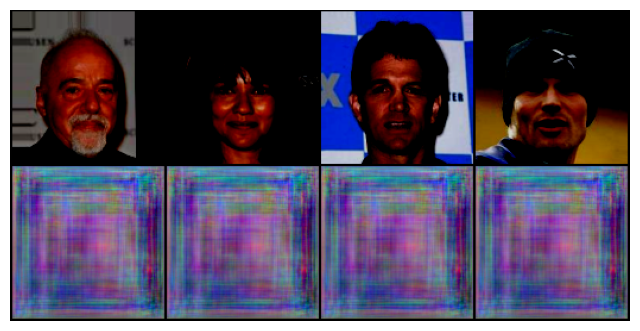

  3%|█▉                                                       | 1000/30390 [12:21<6:02:46,  1.35it/s, GAN_Loss=0, VQ_Loss=1.86]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9285126..1.0].


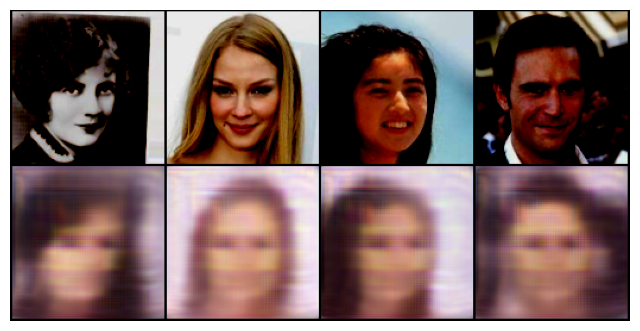

  7%|███▋                                                    | 2000/30390 [24:42<5:50:41,  1.35it/s, GAN_Loss=0, VQ_Loss=0.744]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.90331084..1.0].


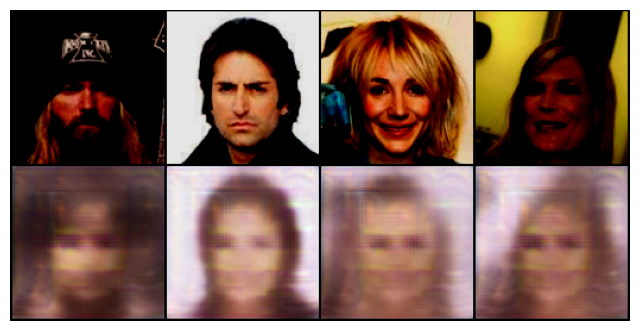

 10%|█████▌                                                  | 3000/30390 [37:03<5:38:33,  1.35it/s, GAN_Loss=0, VQ_Loss=0.571]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


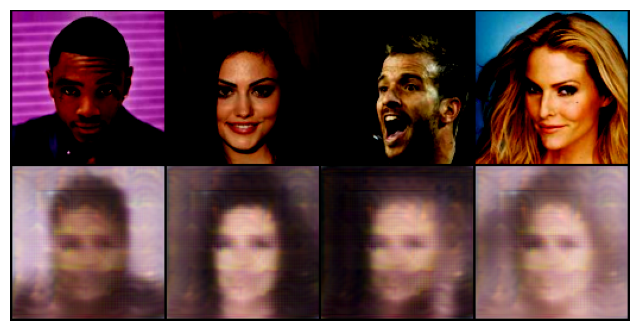

 13%|███████▎                                                | 4000/30390 [49:25<5:26:12,  1.35it/s, GAN_Loss=0, VQ_Loss=0.333]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.95386744..1.0].


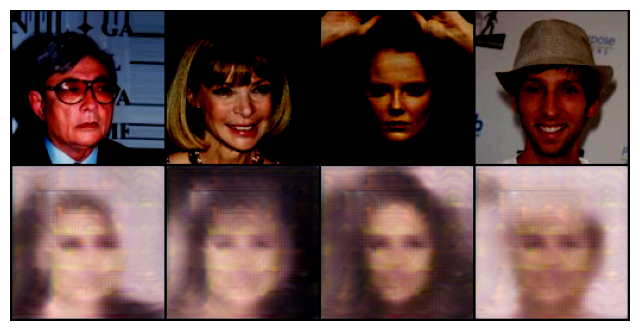

 16%|████████▉                                             | 5000/30390 [1:01:46<5:13:33,  1.35it/s, GAN_Loss=0, VQ_Loss=0.272]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9231304..1.0].


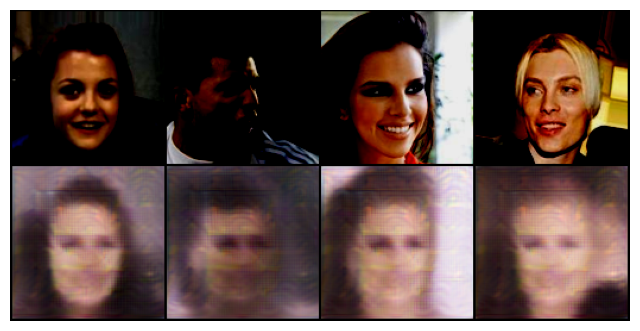

 20%|██████████▋                                           | 6000/30390 [1:14:07<5:01:46,  1.35it/s, GAN_Loss=0, VQ_Loss=0.296]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9126765..1.0].


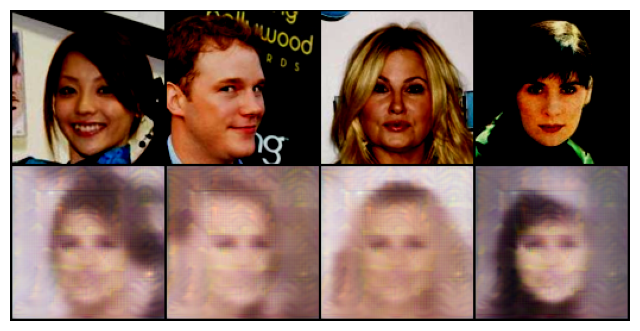

 23%|████████████▍                                         | 7000/30390 [1:26:28<4:48:53,  1.35it/s, GAN_Loss=0, VQ_Loss=0.231]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9417971..1.0].


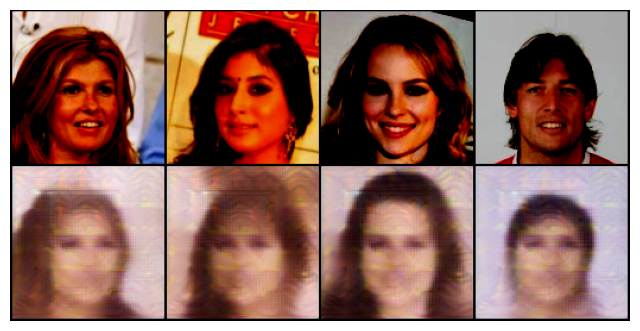

 26%|██████████████▏                                       | 8000/30390 [1:38:50<4:36:32,  1.35it/s, GAN_Loss=0, VQ_Loss=0.189]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.88614684..1.0].


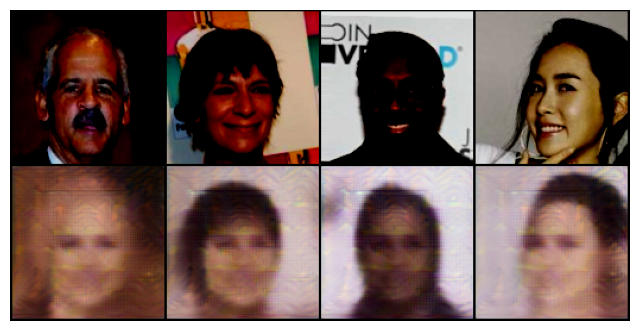

 30%|███████████████▉                                      | 9000/30390 [1:51:11<4:24:17,  1.35it/s, GAN_Loss=0, VQ_Loss=0.227]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.94261545..1.0].


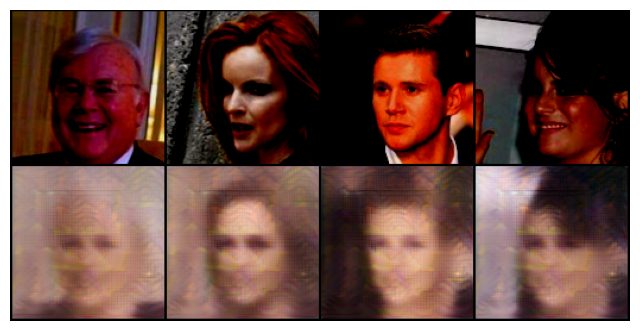

 30%|████████████████                                      | 9050/30390 [1:51:48<4:23:35,  1.35it/s, GAN_Loss=0, VQ_Loss=0.162]IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)

 53%|█████████████████████████▊                       | 16000/30390 [3:18:09<2:57:54,  1.35it/s, GAN_Loss=0.002, VQ_Loss=0.193]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.6556564..1.0].


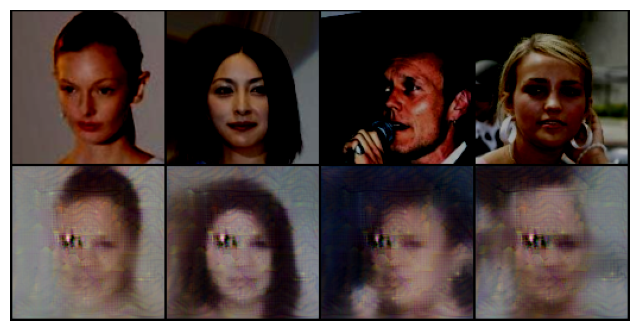

 56%|█████████████████████████████▋                       | 17000/30390 [3:30:35<2:46:39,  1.34it/s, GAN_Loss=0, VQ_Loss=0.163]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.8139167..1.0].


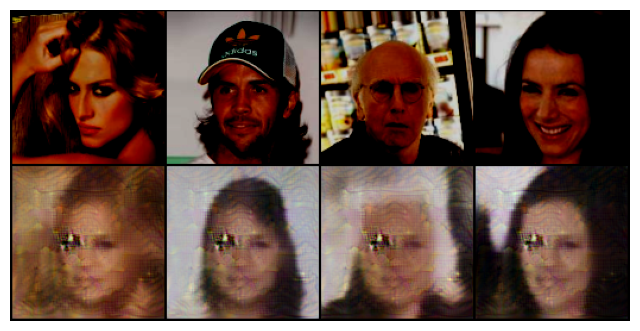

 59%|███████████████████████████████▍                     | 18000/30390 [3:43:00<2:33:41,  1.34it/s, GAN_Loss=0, VQ_Loss=0.159]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.1246787..1.0].


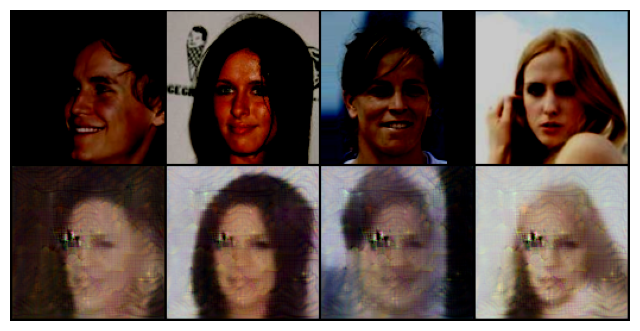

 63%|█████████████████████████████████▏                   | 19000/30390 [3:55:25<2:20:59,  1.35it/s, GAN_Loss=0, VQ_Loss=0.174]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.6749312..1.0].


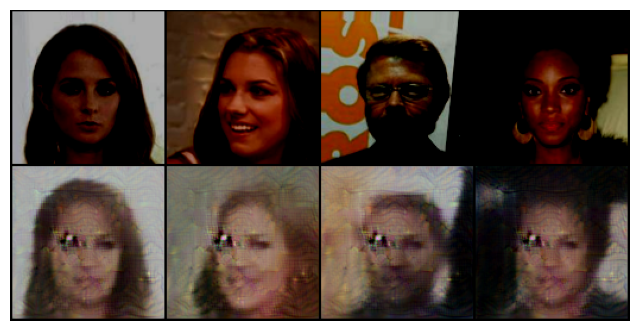

 66%|████████████████████████████████▏                | 20000/30390 [4:07:49<2:08:22,  1.35it/s, GAN_Loss=0.021, VQ_Loss=0.178]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.8218441..1.0].


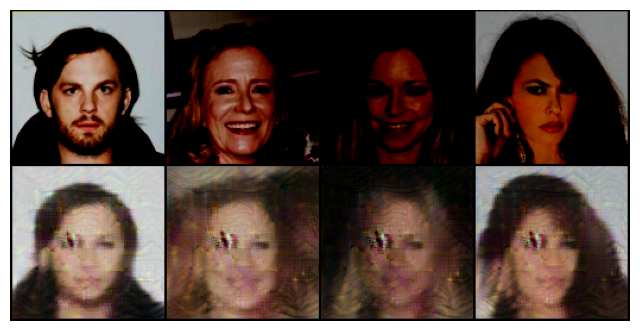

 69%|████████████████████████████████████▌                | 21000/30390 [4:20:14<1:56:55,  1.34it/s, GAN_Loss=0, VQ_Loss=0.145]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.6714651..1.0].


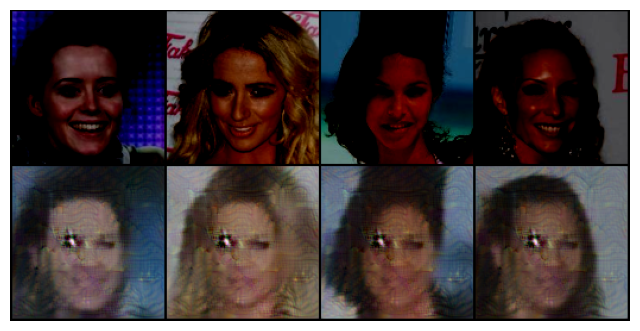

 72%|██████████████████████████████████████▎              | 22000/30390 [4:32:38<1:44:04,  1.34it/s, GAN_Loss=0, VQ_Loss=0.136]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.73065513..1.0].


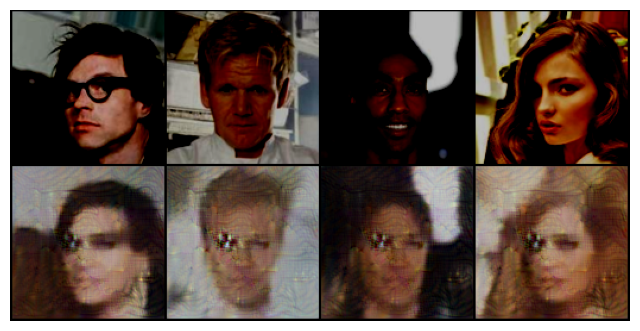

 76%|█████████████████████████████████████            | 23000/30390 [4:45:03<1:31:49,  1.34it/s, GAN_Loss=0.001, VQ_Loss=0.132]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.8630037..1.0].


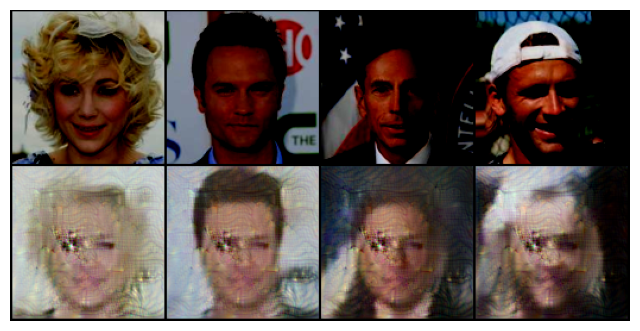

 79%|█████████████████████████████████████████▊           | 24000/30390 [4:57:28<1:19:05,  1.35it/s, GAN_Loss=0, VQ_Loss=0.168]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.7089881..1.0].


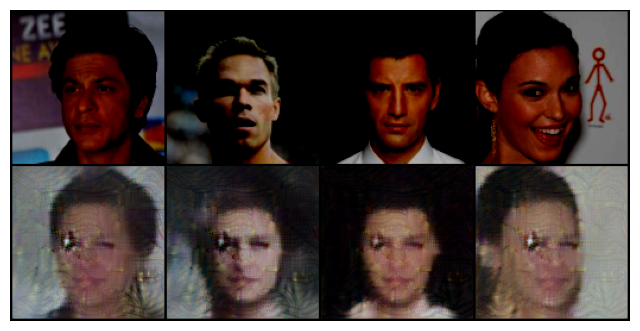

 82%|████████████████████████████████████████▎        | 25000/30390 [5:09:52<1:07:20,  1.33it/s, GAN_Loss=0.002, VQ_Loss=0.148]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.7858325..1.0].


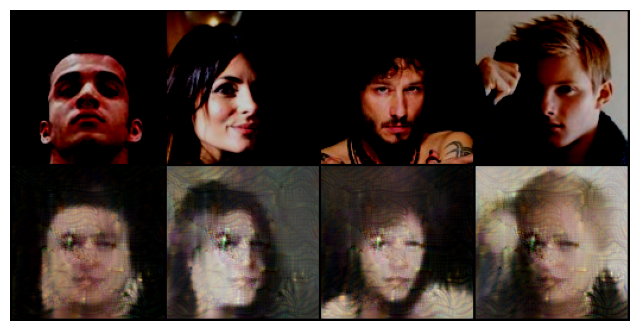

 86%|███████████████████████████████████████████████        | 26000/30390 [5:22:17<54:18,  1.35it/s, GAN_Loss=0, VQ_Loss=0.131]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.8116559..1.0].


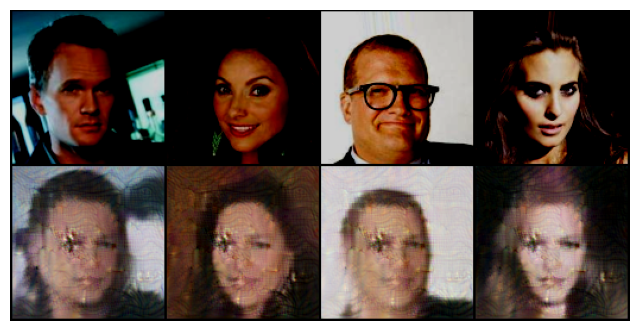

 89%|████████████████████████████████████████████████▊      | 27000/30390 [5:34:41<41:55,  1.35it/s, GAN_Loss=0, VQ_Loss=0.144]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.63601625..1.0].


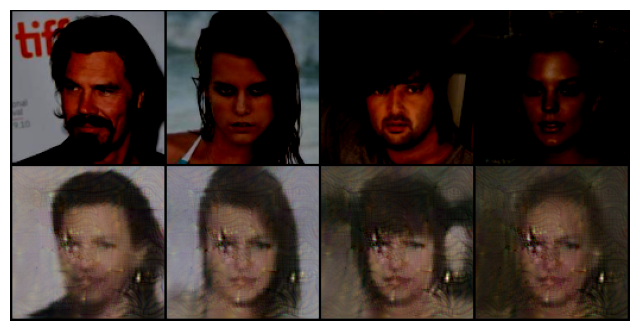

 92%|██████████████████████████████████████████████████▋    | 28000/30390 [5:47:06<29:40,  1.34it/s, GAN_Loss=0, VQ_Loss=0.148]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.72555673..1.0].


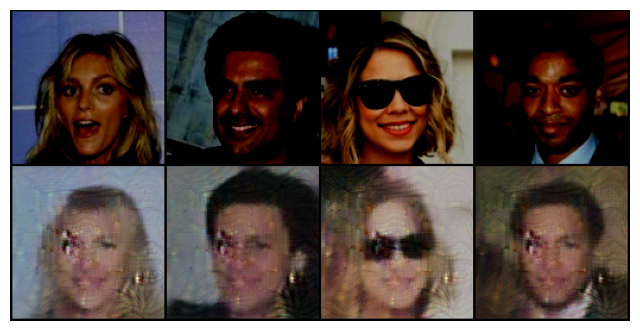

 95%|████████████████████████████████████████████████████▍  | 29000/30390 [5:59:31<17:12,  1.35it/s, GAN_Loss=0, VQ_Loss=0.142]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.5847719..1.0].


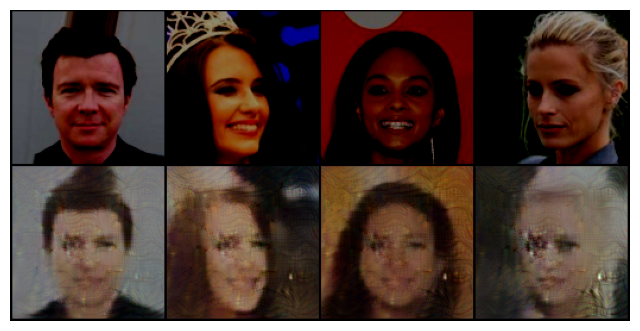

 99%|██████████████████████████████████████████████████▎| 30000/30390 [6:11:57<04:50,  1.34it/s, GAN_Loss=0.007, VQ_Loss=0.146]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.77909225..1.0].


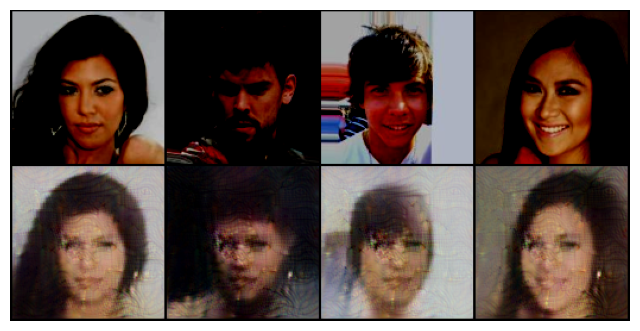

100%|██████████████████████████████████████████████████▉| 30389/30390 [6:16:47<00:00,  1.33it/s, GAN_Loss=0.002, VQ_Loss=0.151]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.5778034..1.0].


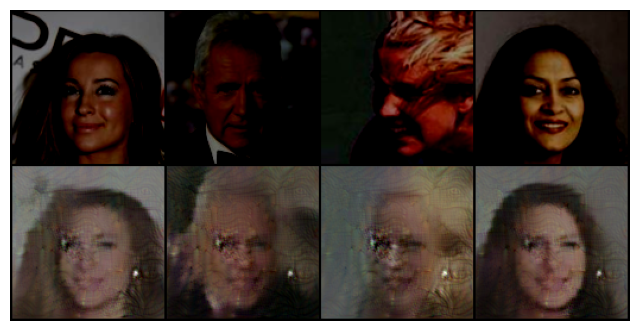

  0%|                                                                                                | 0/30390 [00:00<?, ?it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.63597697..1.0].


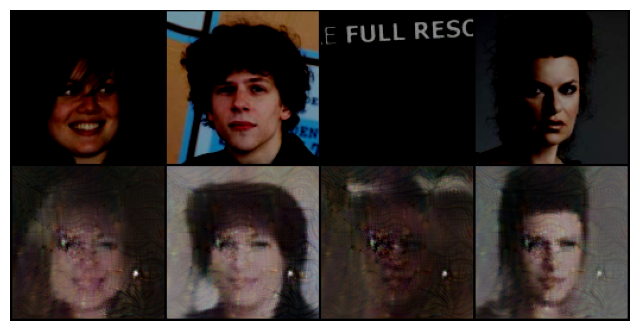

  3%|█▊                                                      | 1000/30390 [12:40<6:03:29,  1.35it/s, GAN_Loss=0, VQ_Loss=0.145]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.87054497..1.0].


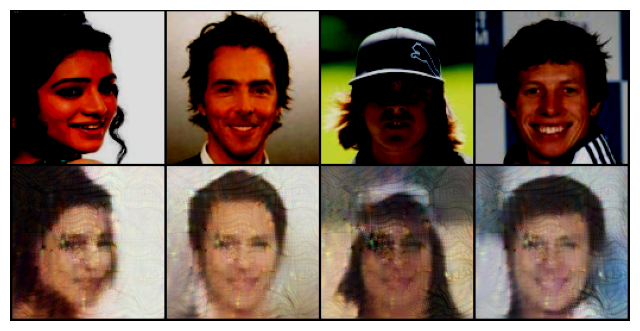

  7%|███▋                                                    | 2000/30390 [25:05<5:52:22,  1.34it/s, GAN_Loss=0, VQ_Loss=0.137]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.8764978..1.0].


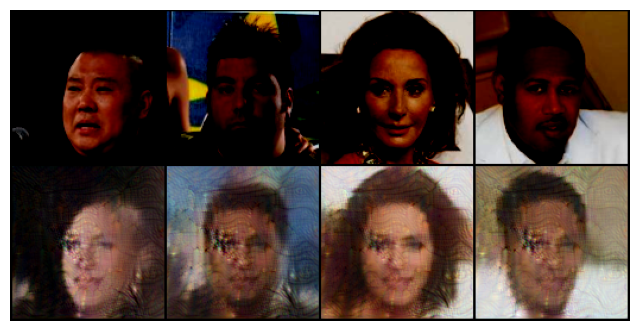

 10%|█████▏                                              | 3000/30390 [37:29<5:39:27,  1.34it/s, GAN_Loss=0.001, VQ_Loss=0.127]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.84240067..1.0].


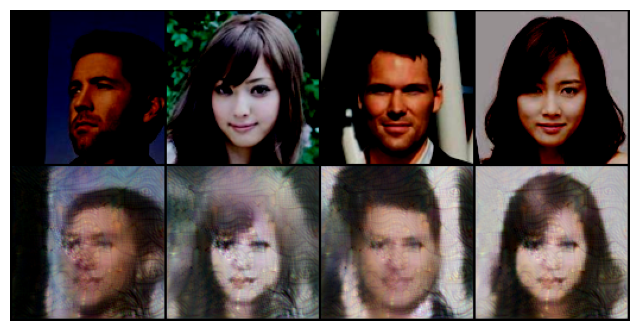

 13%|██████▉                                              | 4000/30390 [49:53<5:26:54,  1.35it/s, GAN_Loss=0.867, VQ_Loss=0.15]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.79481953..1.0].


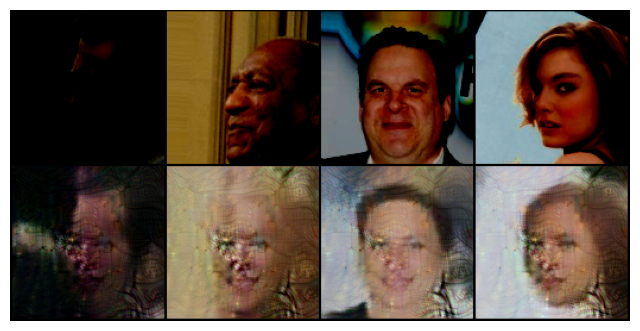

 16%|████████▏                                         | 5000/30390 [1:02:18<5:14:29,  1.35it/s, GAN_Loss=0.001, VQ_Loss=0.127]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.80991995..1.0].


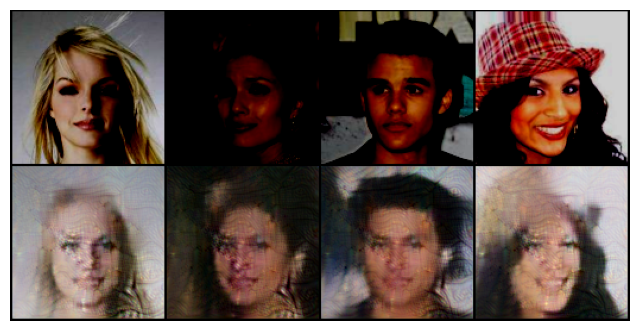

 20%|█████████▊                                        | 6000/30390 [1:14:43<5:02:20,  1.34it/s, GAN_Loss=0.001, VQ_Loss=0.121]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.81897575..1.0].


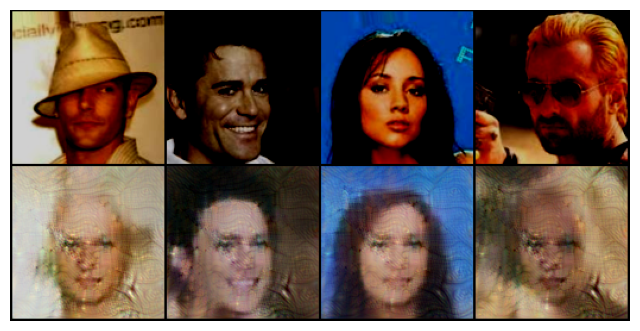

 23%|████████████▍                                         | 7000/30390 [1:27:07<4:50:11,  1.34it/s, GAN_Loss=0, VQ_Loss=0.158]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.8781229..1.0].


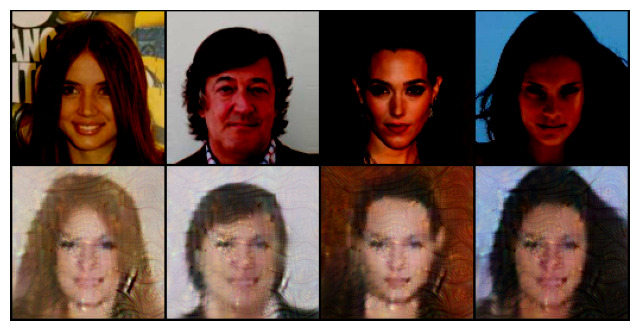

 26%|█████████████▏                                    | 8000/30390 [1:39:31<4:38:54,  1.34it/s, GAN_Loss=0.014, VQ_Loss=0.115]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.8008224..1.0].


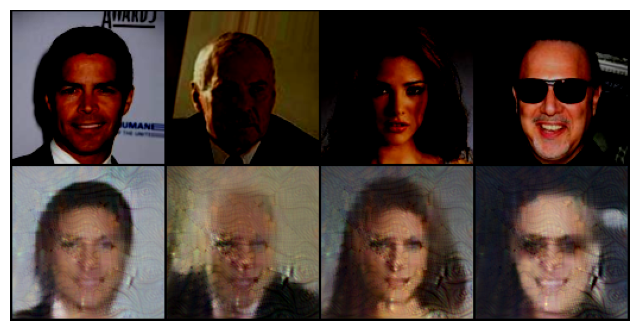

 30%|██████████████▊                                   | 9000/30390 [1:51:55<4:25:47,  1.34it/s, GAN_Loss=0.021, VQ_Loss=0.116]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.8465416..1.0].


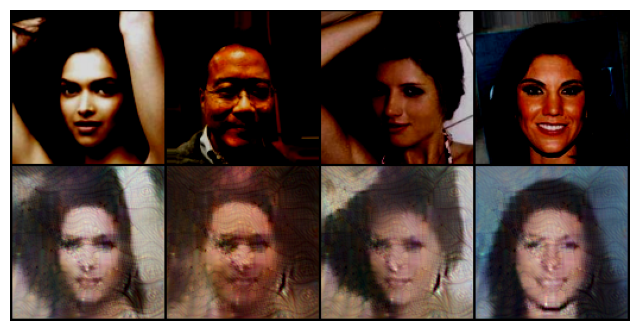

 33%|█████████████████▊                                    | 10000/30390 [2:04:19<4:13:12,  1.34it/s, GAN_Loss=0, VQ_Loss=0.14]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.68417555..1.0].


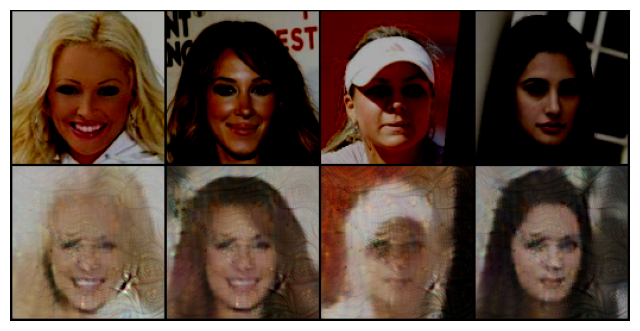

 36%|█████████████████▋                               | 11000/30390 [2:16:43<4:00:13,  1.35it/s, GAN_Loss=0.001, VQ_Loss=0.112]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.8525791..1.0].


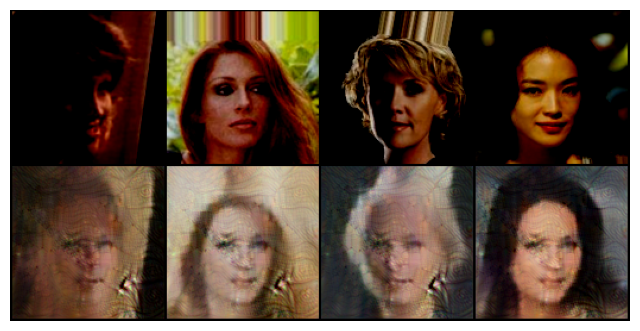

 39%|████████████████████▉                                | 12000/30390 [2:29:07<3:48:14,  1.34it/s, GAN_Loss=0, VQ_Loss=0.159]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.767107..1.0].


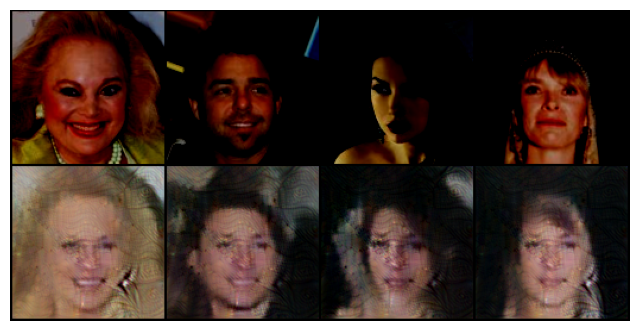

 43%|████████████████████▉                            | 13000/30390 [2:41:32<3:35:18,  1.35it/s, GAN_Loss=0.004, VQ_Loss=0.146]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.7949016..1.0].


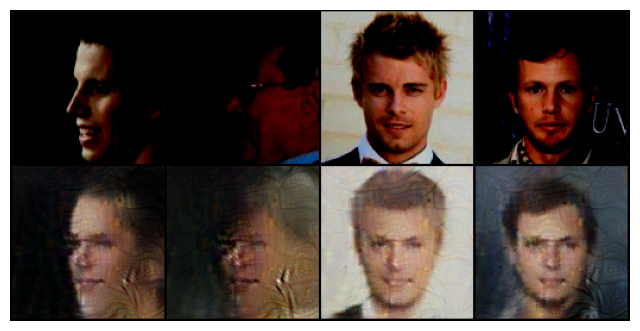

 46%|████████████████████████▍                            | 14000/30390 [2:53:56<3:23:49,  1.34it/s, GAN_Loss=0, VQ_Loss=0.145]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.8296432..1.0].


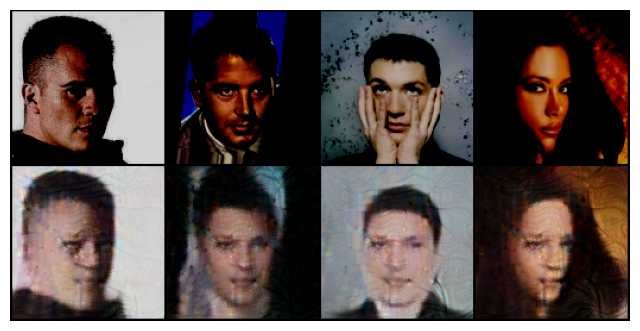

 49%|██████████████████████████▏                          | 15000/30390 [3:06:20<3:10:15,  1.35it/s, GAN_Loss=0, VQ_Loss=0.193]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.7780556..1.0].


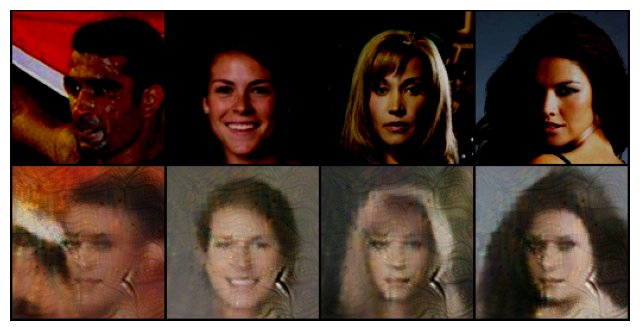

 53%|█████████████████████████▊                       | 16000/30390 [3:18:45<2:58:55,  1.34it/s, GAN_Loss=0.012, VQ_Loss=0.123]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.8045166..1.0].


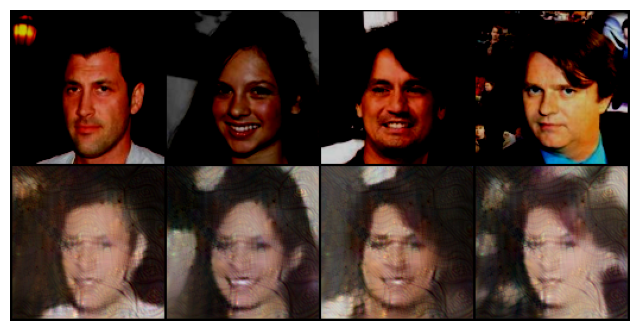

 56%|█████████████████████████████▋                       | 17000/30390 [3:31:08<2:45:57,  1.34it/s, GAN_Loss=0, VQ_Loss=0.119]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.7982726..1.0].


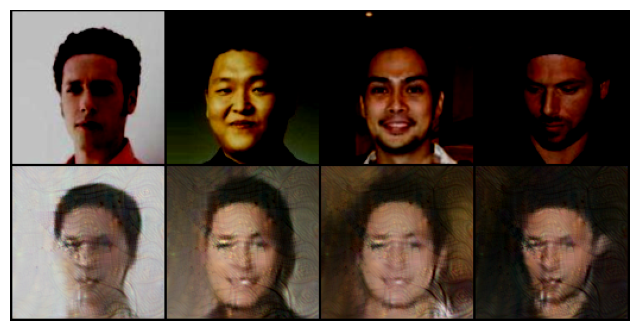

 59%|███████████████████████████████▍                     | 18000/30390 [3:43:32<2:33:40,  1.34it/s, GAN_Loss=0, VQ_Loss=0.169]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.7533313..1.0].


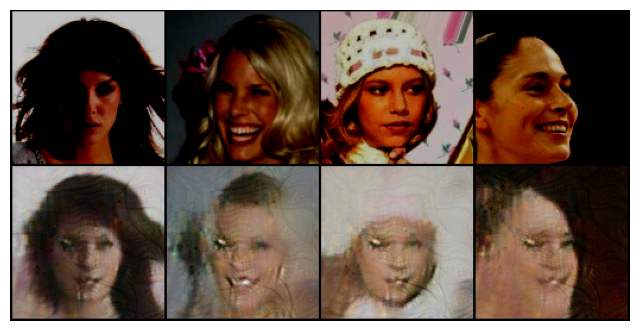

 63%|█████████████████████████████████▏                   | 19000/30390 [3:55:57<2:21:21,  1.34it/s, GAN_Loss=0, VQ_Loss=0.149]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.6662591..1.0].


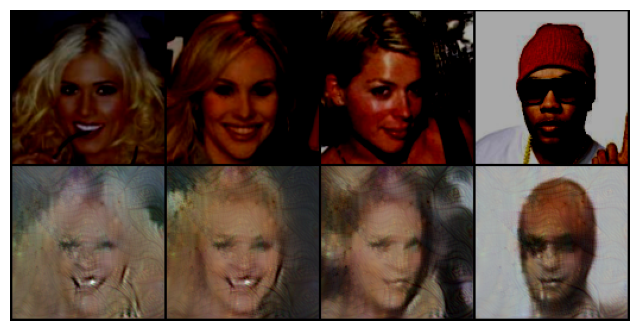

 66%|██████████████████████████████████▉                  | 20000/30390 [4:08:21<2:09:00,  1.34it/s, GAN_Loss=0, VQ_Loss=0.144]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.7490965..1.0].


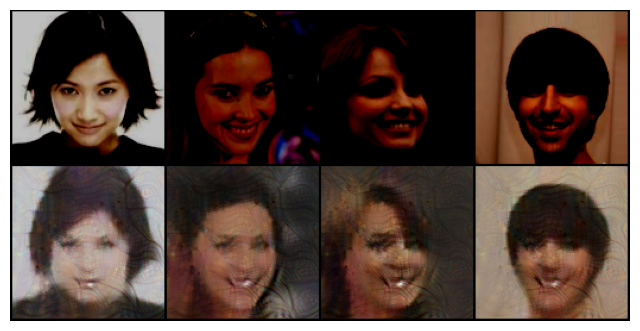

 67%|████████████████████████████████▌                | 20215/30390 [4:11:01<2:06:36,  1.34it/s, GAN_Loss=0.002, VQ_Loss=0.144]IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)

 79%|█████████████████████████████████████████▊           | 24000/30390 [4:57:57<1:19:04,  1.35it/s, GAN_Loss=0, VQ_Loss=0.113]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.62090206..1.0].


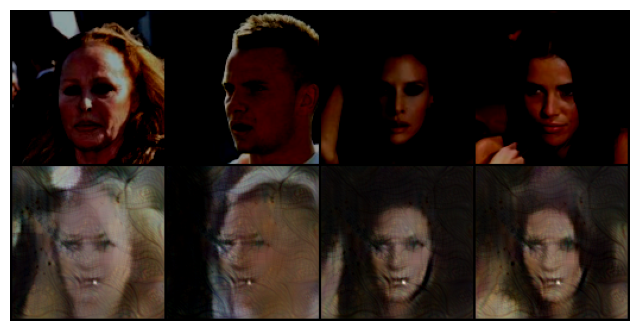

 82%|███████████████████████████████████████████▌         | 25000/30390 [5:10:20<1:06:34,  1.35it/s, GAN_Loss=0, VQ_Loss=0.112]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.7772359..1.0].


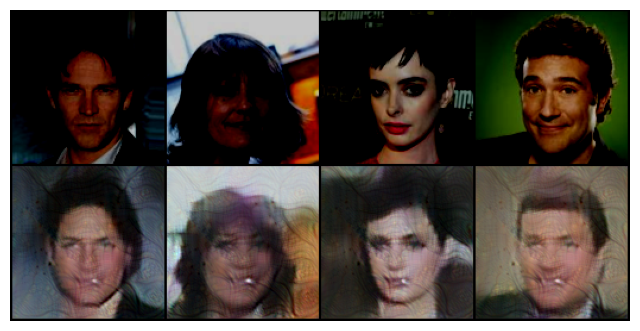

 86%|███████████████████████████████████████████████        | 26000/30390 [5:22:44<54:29,  1.34it/s, GAN_Loss=0, VQ_Loss=0.106]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.7538725..1.0].


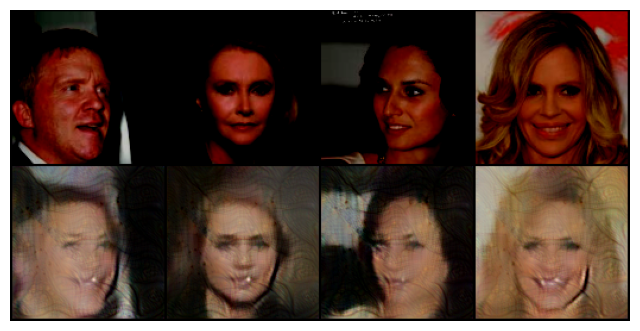

 89%|██████████████████████████████████████████████▏     | 27000/30390 [5:35:09<42:16,  1.34it/s, GAN_Loss=0.02, VQ_Loss=0.109]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.72224..1.0].


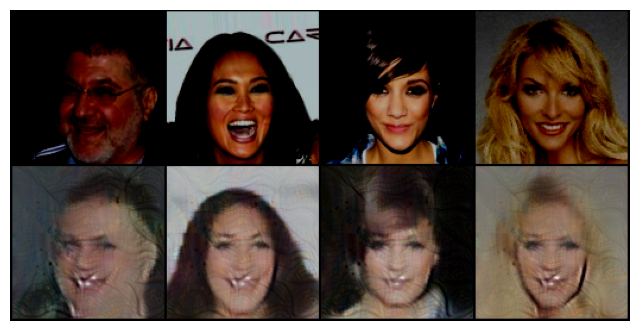

 90%|█████████████████████████████████████████████████▋     | 27425/30390 [5:40:25<36:57,  1.34it/s, GAN_Loss=0, VQ_Loss=0.115]IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)

 23%|████████████▍                                         | 7000/30390 [1:26:56<4:50:28,  1.34it/s, GAN_Loss=0, VQ_Loss=0.132]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.7141729..1.0].


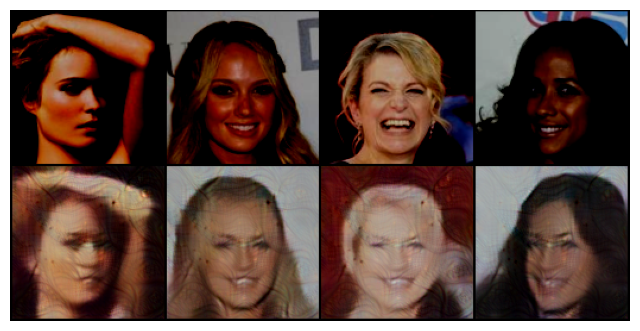

 26%|█████████████▏                                    | 8000/30390 [1:39:21<4:37:48,  1.34it/s, GAN_Loss=0.001, VQ_Loss=0.106]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.8253656..1.0].


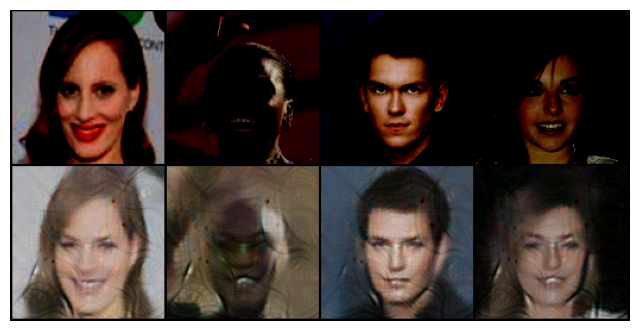

 30%|███████████████▉                                      | 9000/30390 [1:51:46<4:25:52,  1.34it/s, GAN_Loss=0, VQ_Loss=0.136]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.8062662..1.0].


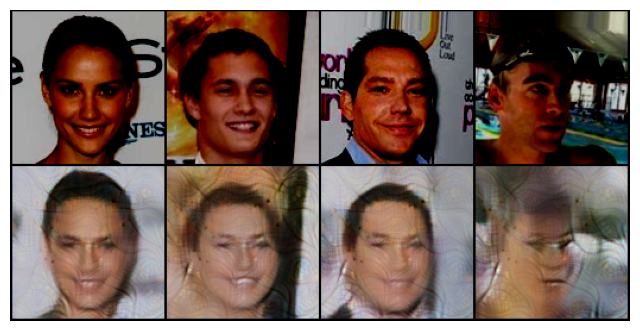

 33%|█████████████████▍                                   | 10000/30390 [2:04:11<4:13:18,  1.34it/s, GAN_Loss=0, VQ_Loss=0.123]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.82031834..1.0].


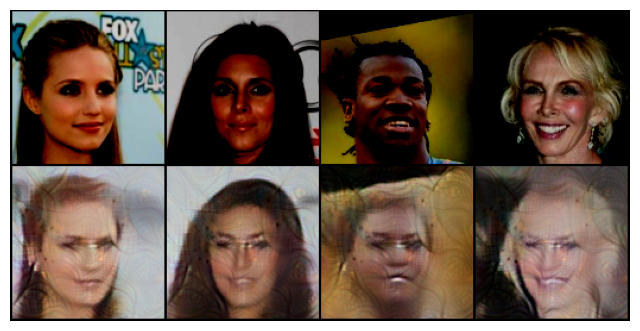

 36%|█████████████████▋                               | 11000/30390 [2:16:36<4:00:17,  1.34it/s, GAN_Loss=0.004, VQ_Loss=0.137]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.75189024..1.0].


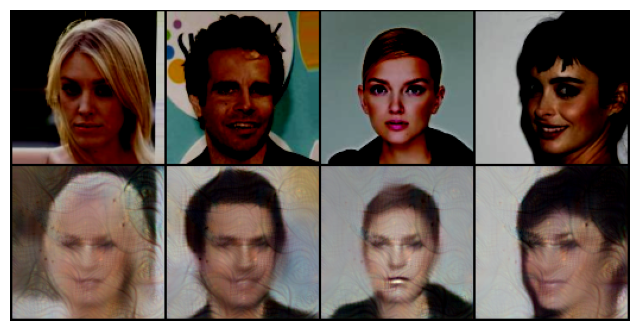

 39%|████████████████████▉                                | 12000/30390 [2:29:00<3:48:39,  1.34it/s, GAN_Loss=0, VQ_Loss=0.163]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.811733..1.0].


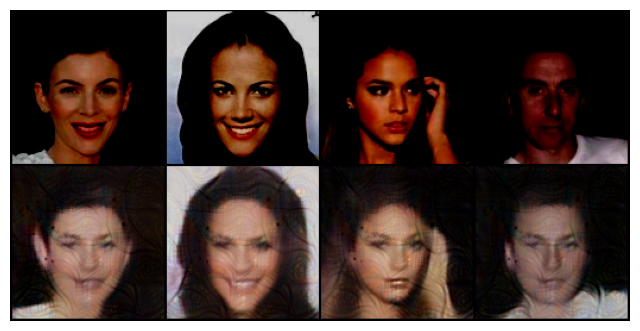

 43%|████████████████████▉                            | 13000/30390 [2:41:25<3:36:22,  1.34it/s, GAN_Loss=0.002, VQ_Loss=0.104]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.8949296..1.0].


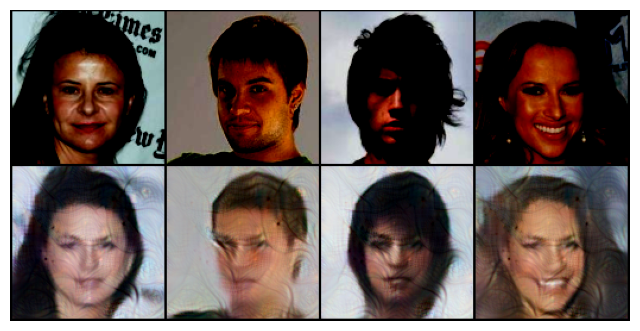

 46%|████████████████████████▍                            | 14000/30390 [2:53:50<3:23:11,  1.34it/s, GAN_Loss=0, VQ_Loss=0.137]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.8981759..1.0].


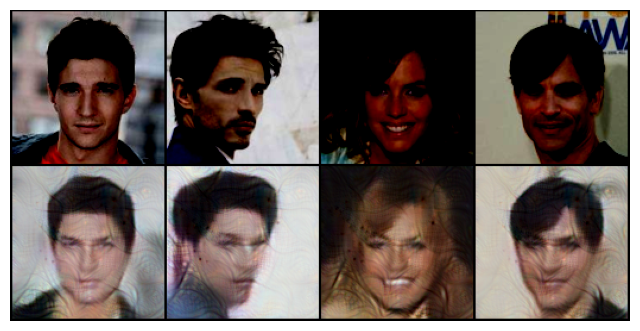

 49%|██████████████████████████▋                           | 15000/30390 [3:06:15<3:10:52,  1.34it/s, GAN_Loss=0, VQ_Loss=0.11]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.862356..1.0].


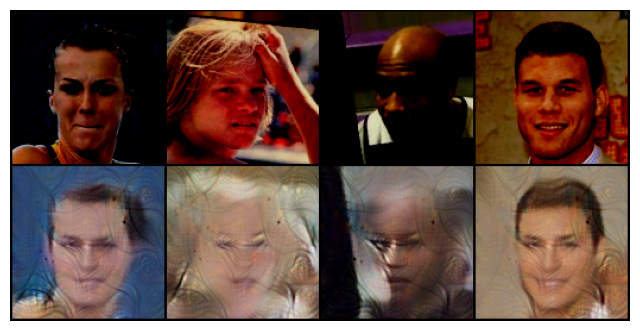

 53%|███████████████████████████▉                         | 16000/30390 [3:18:40<2:58:28,  1.34it/s, GAN_Loss=0, VQ_Loss=0.136]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.79657173..1.0].


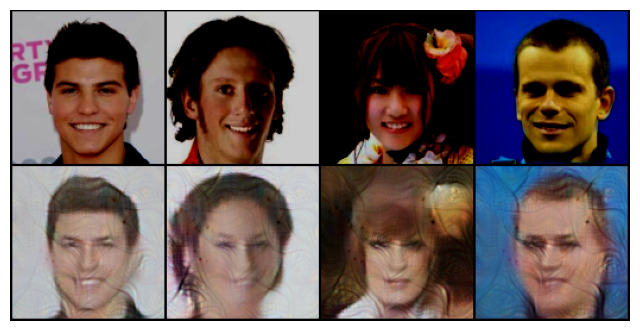

 56%|█████████████████████████████▋                       | 17000/30390 [3:31:05<2:46:42,  1.34it/s, GAN_Loss=0, VQ_Loss=0.114]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.85681415..1.0].


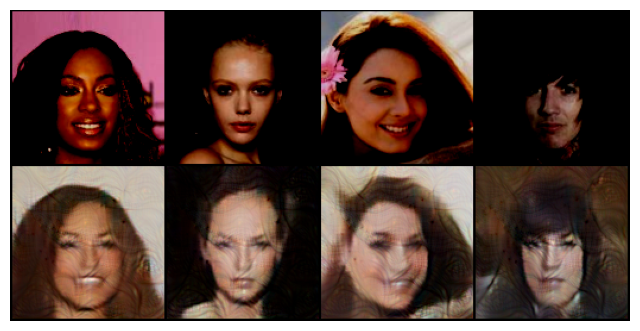

 59%|████████████████████████████▍                   | 18000/30390 [3:43:29<2:33:52,  1.34it/s, GAN_Loss=0.004, VQ_Loss=0.0997]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.87693983..1.0].


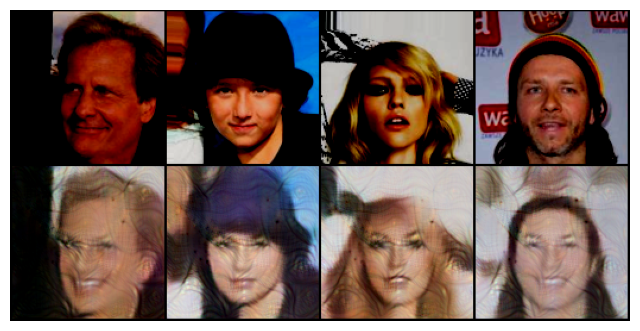

 63%|█████████████████████████████████▏                   | 19000/30390 [3:55:54<2:21:01,  1.35it/s, GAN_Loss=0, VQ_Loss=0.118]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.69302..1.0].


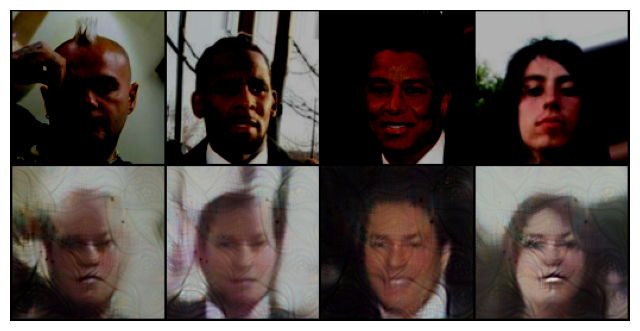

 69%|█████████████████████████████████▊               | 21000/30390 [4:20:44<1:56:18,  1.35it/s, GAN_Loss=0.061, VQ_Loss=0.168]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.85643005..1.0].


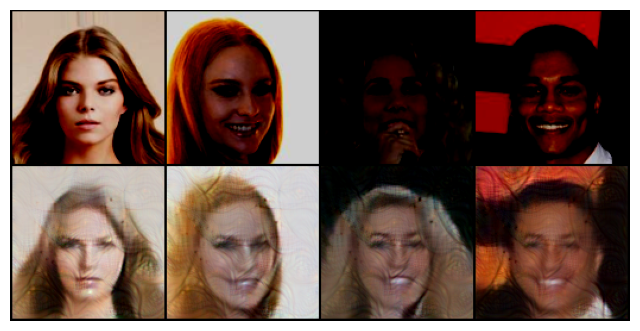

 72%|█████████████████████████████████████▋              | 22000/30390 [4:33:09<1:44:22,  1.34it/s, GAN_Loss=0, VQ_Loss=0.0968]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.8308224..1.0].


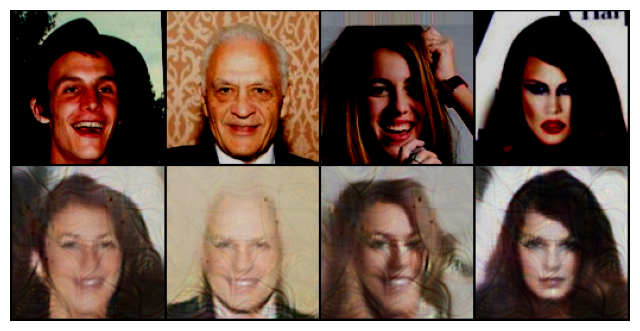

 76%|████████████████████████████████████████             | 23000/30390 [4:45:54<1:31:34,  1.35it/s, GAN_Loss=0, VQ_Loss=0.119]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.90715003..1.0].


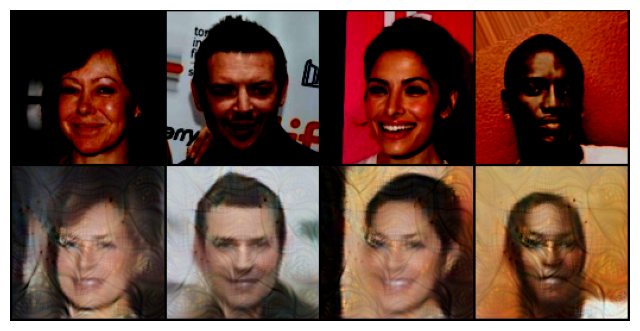

 79%|█████████████████████████████████████████▊           | 24000/30390 [4:58:20<1:19:33,  1.34it/s, GAN_Loss=0, VQ_Loss=0.108]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.7184568..1.0].


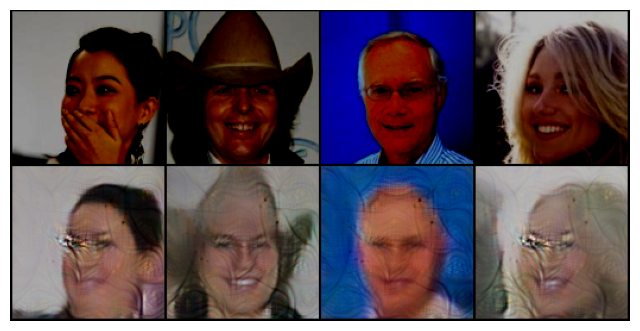

 82%|███████████████████████████████████████████▌         | 25000/30390 [5:11:06<1:09:17,  1.30it/s, GAN_Loss=0, VQ_Loss=0.123]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.75160193..1.0].


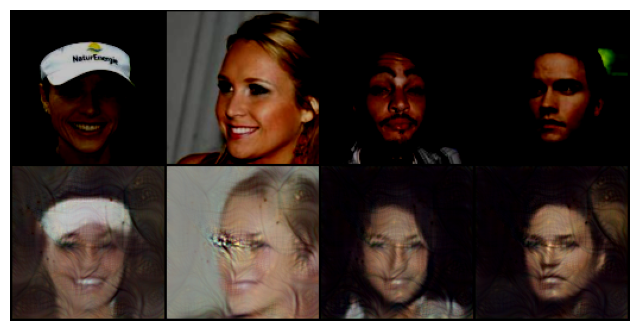

 86%|███████████████████████████████████████████████        | 26000/30390 [5:23:32<54:33,  1.34it/s, GAN_Loss=0, VQ_Loss=0.129]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.77910966..1.0].


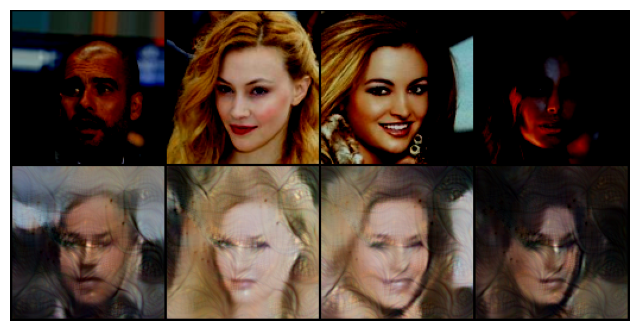

 89%|█████████████████████████████████████████████▎     | 27000/30390 [5:36:18<42:11,  1.34it/s, GAN_Loss=0.066, VQ_Loss=0.176]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.8053466..1.0].


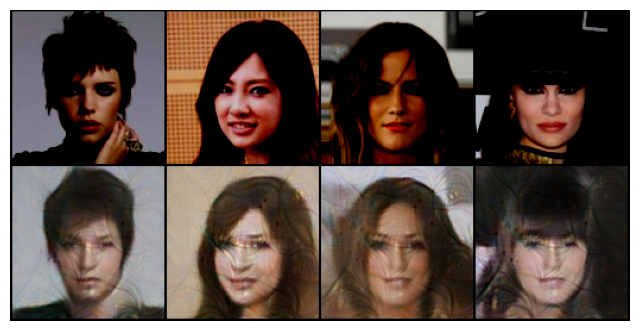

 92%|███████████████████████████████████████████████▉    | 28000/30390 [5:48:43<29:40,  1.34it/s, GAN_Loss=0.01, VQ_Loss=0.109]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.85734236..1.0].


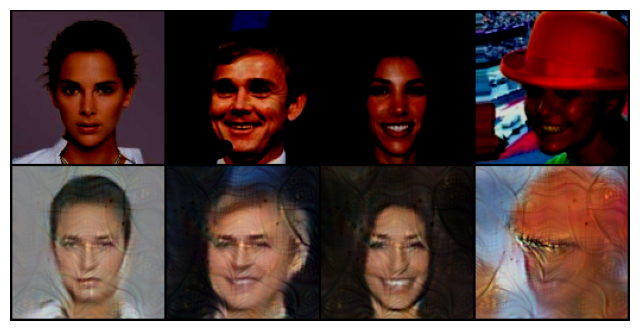

 95%|████████████████████████████████████████████████████   | 28790/30390 [5:58:45<26:14,  1.02it/s, GAN_Loss=0, VQ_Loss=0.145]IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)

100%|██████████████████████████████████████████████████▉| 30389/30390 [6:18:45<00:00,  1.33it/s, GAN_Loss=0.005, VQ_Loss=0.109]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.87473655..1.0].


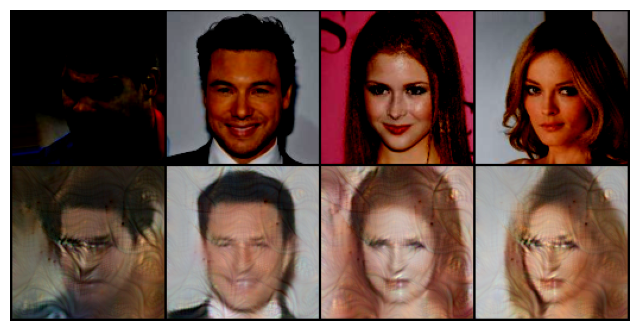

  0%|                                                                                                | 0/30390 [00:00<?, ?it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.8772566..1.0].


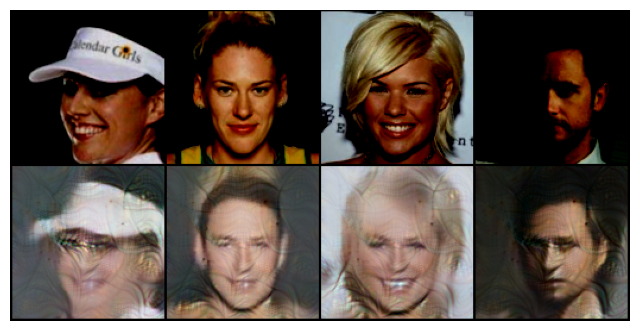

  3%|█▋                                                   | 1000/30390 [12:25<6:05:07,  1.34it/s, GAN_Loss=0.01, VQ_Loss=0.114]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.7395184..1.0].


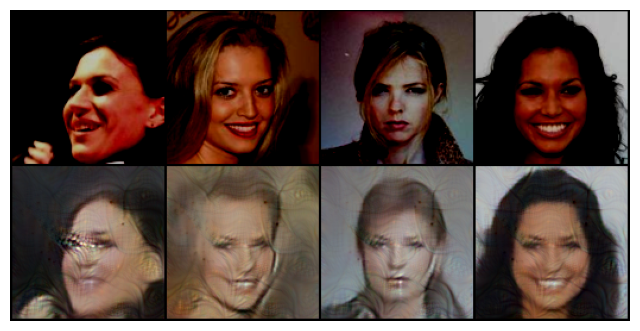

  7%|███▋                                                    | 2000/30390 [25:10<5:52:42,  1.34it/s, GAN_Loss=0, VQ_Loss=0.122]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.8857007..1.0].


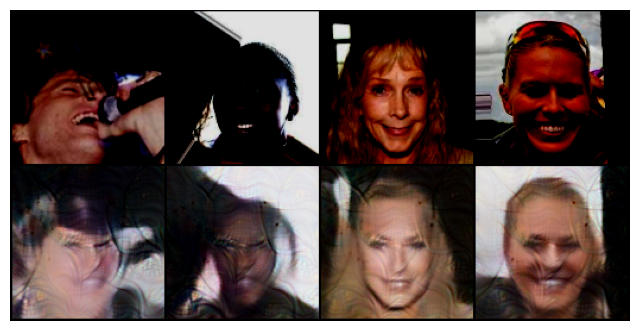

 10%|█████▏                                              | 3000/30390 [37:36<5:40:42,  1.34it/s, GAN_Loss=0.001, VQ_Loss=0.123]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.71867234..1.0].


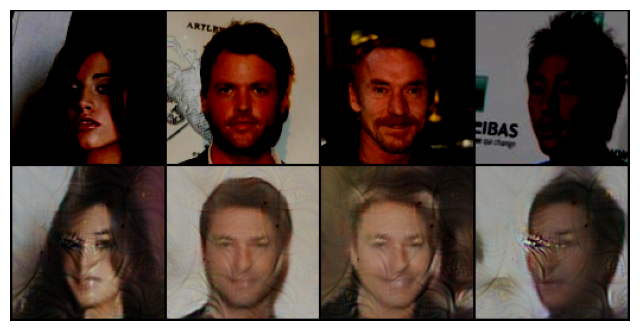

 13%|███████▎                                                | 4000/30390 [50:03<5:27:52,  1.34it/s, GAN_Loss=0, VQ_Loss=0.125]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.89246494..1.0].


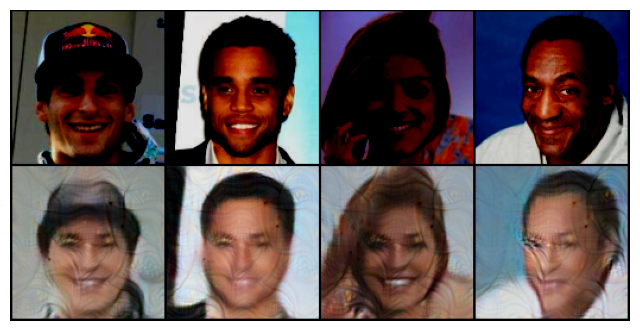

 14%|███████▉                                                | 4329/30390 [54:09<5:26:02,  1.33it/s, GAN_Loss=0, VQ_Loss=0.138]


KeyboardInterrupt: 

In [13]:
trainer = TrainVQGAN(args)
trainer.train(args, train_dataloader)